# Homework 2 (100 Points)

**Kevin Smith U76047763**

**Sarina Singh U69992014**

## Exercise 1 - (50 points)

This exercise will be using the [AirBnB dataset](http://insideairbnb.com/get-the-data.html) for New York City called `listings.csv`. You should find this data in your downloaded repository. If not, it is a resource under Piazza.

a) Produce a [Marker Cluster](https://deparkes.co.uk/2016/06/24/folium-marker-clusters/) using the Folium and Selenium package (you can install them using pip) of the mean listing price per location (lattitude and longitude) over the New York City map. (5 points)

To start, generate a base map of New York City to plot over: (**`location=[40.693943, -73.985880], zoom_start = 11`**). Then, generate and save a `PNG` file named `problem1a.png`. Display it in the cell below as well using the `IPython.display` package.

CREATED MAP


/var/folders/n1/mp2n6fsd09963xzzjvzq12g80000gn/T/ipykernel_22887/149059422.py:8: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  listings = pd.read_csv('listings.csv')


CREATED DATAFRAME
CREATED MARKER CLUSTER


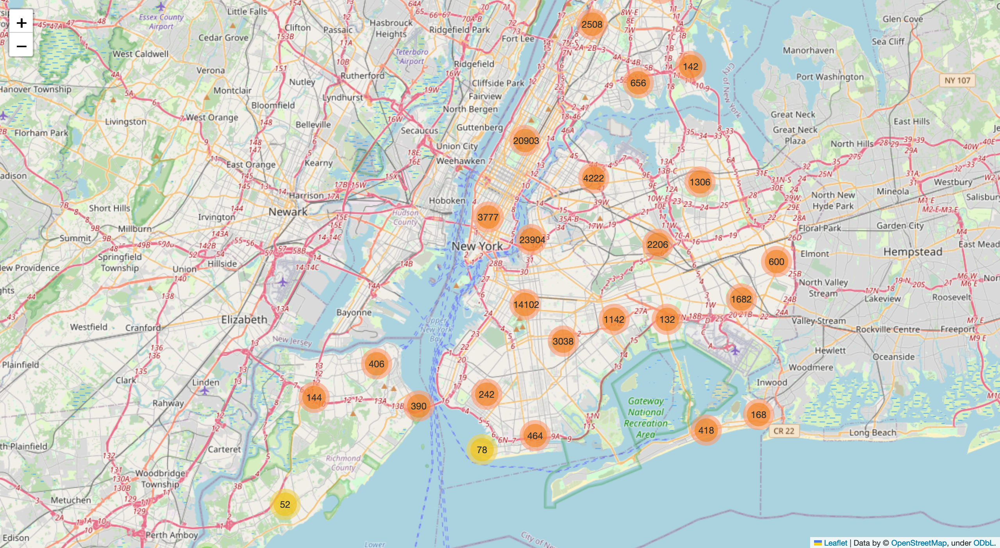

In [6]:
from folium.plugins import MarkerCluster, FastMarkerCluster #Using either is fine but I prefer FastMarkerCluster.

# Write your code below! Leave the instantiated variables: it is for your convenience.

nyc_map = folium.Map(location=[40.693943, -73.985880], zoom_start=11)
print("CREATED MAP")

listings = pd.read_csv('listings.csv')
print("CREATED DATAFRAME")

marker_cluster = folium.plugins.FastMarkerCluster(listings[['latitude', 'longitude']] ).add_to(nyc_map)
print("CREATED MARKER CLUSTER")

for index, row in listings.iterrows():
    latitude = row['latitude']
    longitude = row['longitude']
    price = row['price']
    
    folium.Marker(location=[latitude, longitude], popup=f'Price: ${price:.2f}').add_to(marker_cluster)

convert_map_to_png(nyc_map, 'problem1a')

b) Plot a bar chart of the average price per neighbourhood group. Briefly comment on the relation between the price and neighbourhood group (use your map to analyze it). - (2.5 pts)

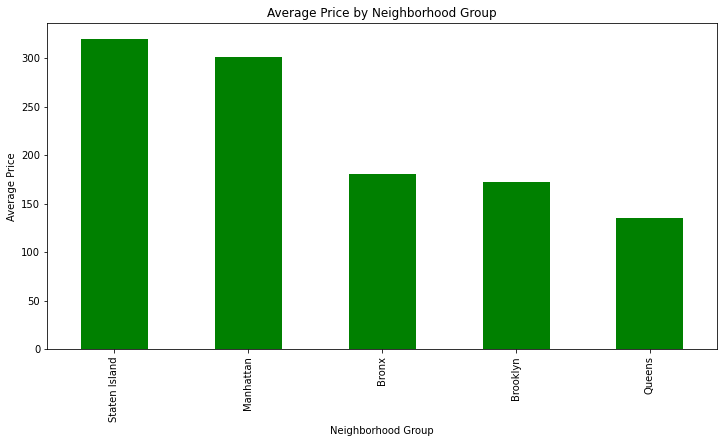

In [12]:
import matplotlib.pyplot as plt

neighborhood_prices = listings.groupby('neighbourhood_group')['price'].mean()

neighborhood_prices = neighborhood_prices.sort_values(ascending=False)

plt.figure(figsize=(12, 6))
neighborhood_prices.plot(kind='bar', color='green')

plt.xlabel('Neighborhood Group')
plt.ylabel('Average Price')
plt.title('Average Price by Neighborhood Group')

plt.show()

One might expect Manhattan to be the most expensive, but my guess is that since Staten Island is a lot more residential with more space, a majority of listings there are for entire houses (which would be more expensive) meanwhile listings in the city are more likely smaller spaces with lower average price. Otherwise it makes sense that Queens would be the least expensive, given its distance from downtown Manhattan.

c) You're going to be living in New York City long term so you'd like to find places you can stay that are at minimum 300 days (inclusive). Plot a map that displays all the locations of these places. (Note: some could be in the same location) - (5 pts)


Showing 10834 unique locations with availability >= 300 on the map:


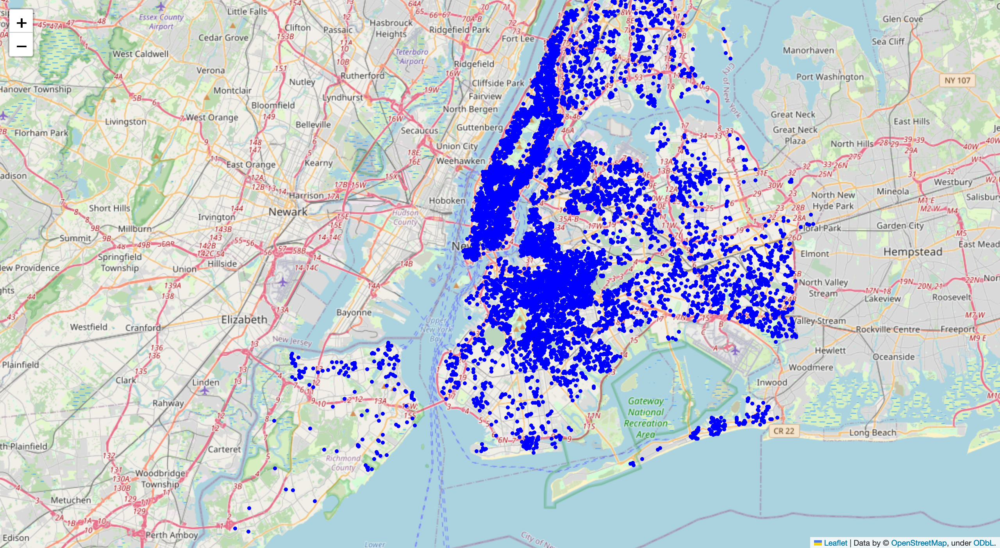

In [31]:
# Write your code below! Leave the instantiated variables: it is for your convenience.
validRows = listings[listings['availability_365'] >= 300]
validRows = validRows.drop_duplicates(subset=['longitude', 'latitude'])
print("Showing",len(validRows),"unique locations with availability >= 300 on the map:")

nyc_map_2 = folium.Map(location=[40.693943, -73.985880], zoom_start=11)

for index, row in validRows.iterrows():
    marker = folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=1, 
                                 color='blue', fill=True,
                                 fill_color='blue', fill_opacity=1)
    marker.add_to(nyc_map_2)

convert_map_to_png(nyc_map_2, 'problem1c')

d) Using `longitude`, `latitude`, `price`, and `number_of_reviews`, use Density-based clustering to create clusters. Plot the points on the NYC map in a color corresponding to their cluster (color could be randomly assigned, but ensure each datapoint is colored to its associated cluster). 
For using `DBSCAN`, have the settings **`eps=0.3, min_samples=10`**. Use a `CircleMarker` with `radius=1`. Plot the clusters on the map and print the number of clusters made. - (15 pts)

Number of clusters: 3


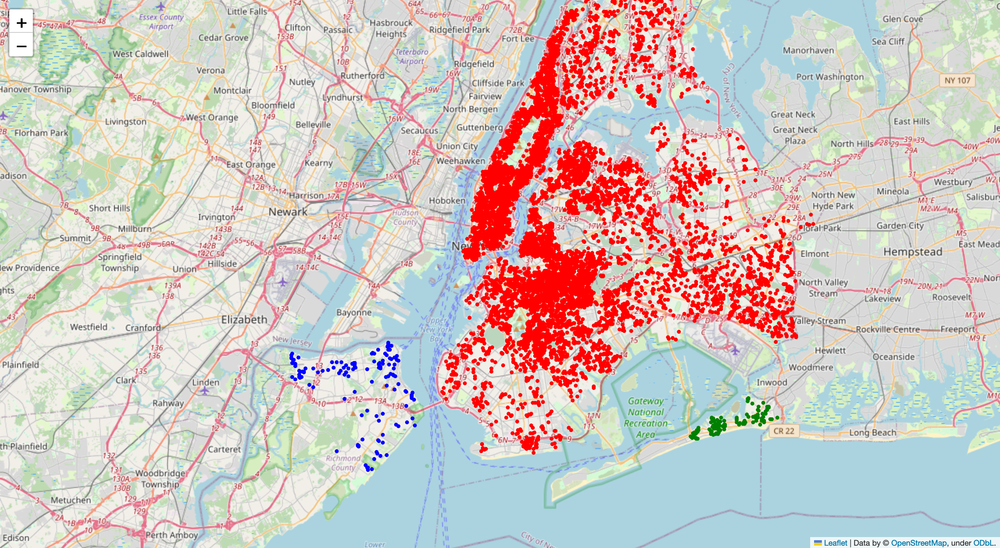

In [50]:
# Write your code below! Leave the instantiated variables: it is for your convenience.
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

nyc_map_3 = folium.Map(location=[40.693943, -73.985880], zoom_start=11)


validRows = listings[listings['availability_365'] >= 300]
validRows = validRows.drop_duplicates(subset=['longitude', 'latitude'])
validRows = validRows[['longitude', 'latitude']]
scaled_data = StandardScaler().fit_transform(validRows)

dbscan = DBSCAN(eps=0.3, min_samples=10)
clusters = dbscan.fit_predict(scaled_data)

cluster_colors = ['red', 'blue', 'green', 'purple',
                  'orange', 'darkred', 'lightred', 'beige',
                  'darkblue', 'darkgreen', 'cadetblue', 'darkpurple',
                  'white', 'pink', 'lightblue', 'lightgreen',
                  'gray', 'black', 'lightgray']
j=0
for i, row in validRows.iterrows():
    latitude, longitude, cluster = row['latitude'], row['longitude'], clusters[j]
    j += 1
    if cluster != -1:  # Skip outliers
        marker = folium.CircleMarker(location=[latitude, longitude], radius=1, 
                                     color=cluster_colors[cluster%(len(cluster_colors))], fill=True,
                                     fill_color=cluster_colors[cluster%(len(cluster_colors))], fill_opacity=1)
        marker.add_to(nyc_map_3)

        
unique_clusters = set(clusters)
unique_clusters.discard(-1) #outliers
num_clusters = len(unique_clusters)

print("Number of clusters:",num_clusters)
convert_map_to_png(nyc_map_3, 'problem1d')

e) What would happen if you were to increase/decrease `eps`, and what would happen if you were to increase/decrease `min_samples`? Give some examples when running part d (you don't have to give the map image, just say something such as "When testing part d with ... ") - (5 points)

When increasing eps to 0.5, I got only 2 clusters instead of 3, but when decreasing it to 0.1, I got 26 clusters, which makes sense - if our neighborhood range is smaller, DBSCAN will give lots more independent clusters.

When increasing min_points to 20, I got 22 clusters, which doesn't make a ton of sense - I would've thought that there would be fewer clusters since increasing min_points makes it harder for a point to qualify as a core point.

Finally, when decreasing min_points to 5, I got 28 clusters, the most of any parameter tweak. This makes sense to me, as it makes it much easier for a point to be classified as a core point, making more clusters.

f) For part d, were the clusters seemed to be scattered or grouped together? Justify your answer. - (2.5 points)

They look pretty logically grouped together to me – one cluster for the four main boroughs (which are very inter-connected), one cluster for Staten Island, which is fairly separated from the rest of the city, and one small cluster in the south-east past the airport.

g) For all listings of type `Shared room`, plot the dendrogram of the hierarchical clustering generated from `longitude`, `latitude`, and `price`. You can use any distance function. Describe your findings. - (10 points)

/opt/anaconda3/lib/python3.9/site-packages/scipy/cluster/hierarchy.py:2841: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim([0, dvw])


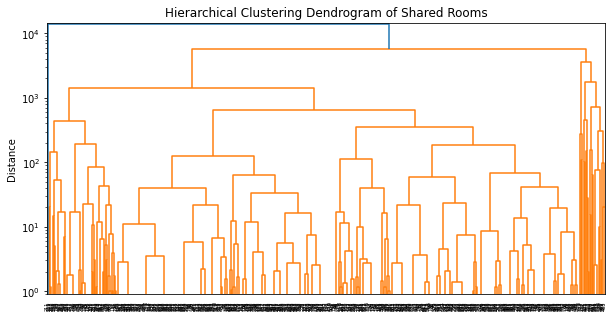

In [56]:
from scipy.cluster import hierarchy

shared_room_data = listings[listings['room_type'] == 'Shared room'][['longitude', 'latitude', 'price']]

link = hierarchy.linkage(shared_room_data, method='ward')

plt.figure(figsize=(10, 5))
plt.yscale("log")
plt.ylabel("Distance")
plt.title('Hierarchical Clustering Dendrogram of Shared Rooms')
hierarchy.dendrogram(link)
plt.show()

There seem to be a few quite dense clusters, with one very dense cluster (farthest to the right) which all then seem to merge with each other at fairly similar rates, suggesting similar distances between original clusters.

h) Normalize `longitude`, `latitude`, and `price` by subtracting by the mean (of the column) and dividing by the standard deviation (of the column). Repeat g) using the normalized data. Comment on what you observe. - (5 points)

/opt/anaconda3/lib/python3.9/site-packages/scipy/cluster/hierarchy.py:2841: UserWarning: Attempted to set non-positive bottom ylim on a log-scaled axis.
Invalid limit will be ignored.
  ax.set_ylim([0, dvw])


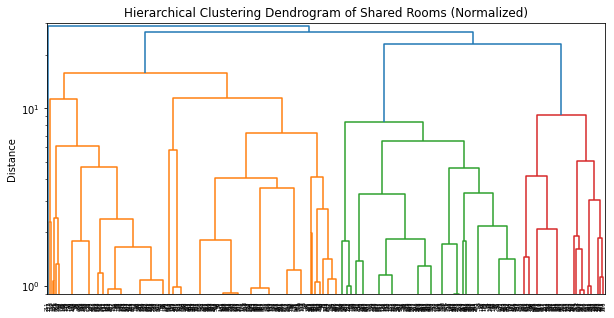

In [55]:
SRdata = listings[listings['room_type'] == 'Shared room'][['longitude', 'latitude', 'price']]

for column_name in ['longitude','latitude','price']:
    mean = SRdata[column_name].mean()
    std = SRdata[column_name].std()
    SRdata[column_name] = (SRdata[column_name] - mean) / std
    
link = hierarchy.linkage(SRdata, method='ward')

plt.figure(figsize=(10, 5))
plt.yscale("log")
plt.ylabel("Distance")
plt.title('Hierarchical Clustering Dendrogram of Shared Rooms (Normalized)')
hierarchy.dendrogram(link)
plt.show()

The dendrogram is much easier to understand and visualize, showing different colors for each cluster (why did that happen?) Additionally, the Y scale (distance) has much smaller values, showing how normalizing the data can reduce the numerical distance between datapoints yet more accurately portray the relationships between those distances.

## Exercise 2 (50 points)

a) Fetch the "mnist_784" data and store is as a `.csv` (that way you don't have to fetch it every time - which takes about 30s). (2.5 points)

In [57]:
import matplotlib.pyplot as plt

import pandas as pd
import numpy as np

from sklearn.datasets import fetch_openml

X, y = fetch_openml(name="mnist_784", version=1, return_X_y=True, as_frame=False)

# your code here

mnist_df = pd.DataFrame(data=X, columns=[str(i) for i in range(X.shape[1])])
print(y)
mnist_df["label"] = y

# Save the DataFrame as a CSV file
mnist_df.to_csv("mnist_784.csv", index=False)


['5' '0' '4' ... '4' '5' '6']


b) Plot the singular value plot for a single example of the 9 digit (2.5 points)

Digit 9
         0    1    2    3    4    5    6    7    8    9  ...  775  776  777  \
4      0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   
19     0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   
22     0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   
33     0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   
43     0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   
...    ...  ...  ...  ...  ...  ...  ...  ...  ...  ...  ...  ...  ...  ...   
69924  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   
69932  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   
69945  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   
69973  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   
69992  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.0  0.0   

       778  779  780  781  782  783  label 

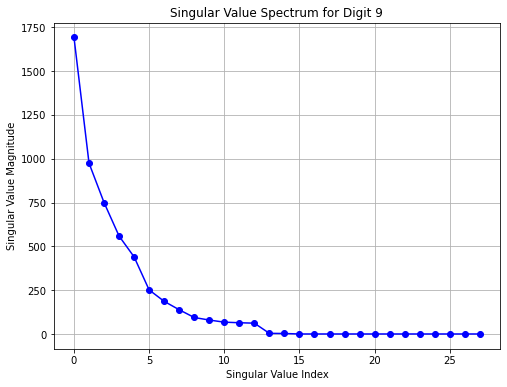

In [58]:
import numpy as np
import matplotlib.pyplot as plt

df = pd.read_csv("mnist_784.csv")
#print(df.head())

# Filter the data to get only examples of the digit 9
digit_9_data = mnist_df[mnist_df["label"] == "9"]

print("Digit 9")
print(digit_9_data)

example_9 = digit_9_data.iloc[0, :-1].values
#print(example_9.shape)
#print(example_9)
example_9 = example_9.reshape(28, 28).astype(float)
U, S, V = np.linalg.svd(example_9)

# Plot the singular values
plt.figure(figsize=(8, 6))
plt.plot(S, marker='o', linestyle='-', color='b')
plt.title("Singular Value Spectrum for Digit 9")
plt.xlabel("Singular Value Index")
plt.ylabel("Singular Value Magnitude")
plt.grid(True)
plt.show()

c) Just like we did in class with the image of the boat: By setting some singular values to 0, plot the approximation of an image of a 9 digit next to the original image. (5 points)

Looking at the plot above, we chose to drop keep around 10 singular values since that seems to be the elbow of the graph of the singular values of the image. 

[1.69170944e+03 9.74547105e+02 7.49820793e+02 5.58569034e+02
 4.39707466e+02 2.51261657e+02 1.86229378e+02 1.38203835e+02
 9.40287837e+01 7.94566762e+01 6.73886531e+01 6.41126747e+01
 6.16336482e+01 3.62269805e+00 2.73972990e+00 1.15327768e-13
 1.15327768e-13 1.15327768e-13 1.15327768e-13 1.15327768e-13
 1.15327768e-13 1.15327768e-13 1.15327768e-13 1.15327768e-13
 1.15327768e-13 1.15327768e-13 1.15327768e-13 1.15327768e-13]
[1691.70943693  974.54710463  749.82079269  558.56903435  439.70746557
  251.26165671  186.22937782  138.20383547   94.02878375   79.45667619
    0.            0.            0.            0.            0.
    0.            0.            0.            0.            0.
    0.            0.            0.            0.            0.
    0.            0.            0.        ]
(28, 28)
(28,)
(28, 28)
(28, 28)


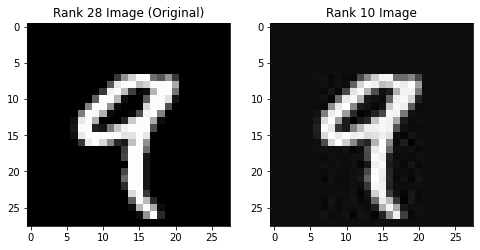

In [59]:
# Filter the data to get only examples of the digit 9

num_singular_to_keep = 10  # You can change this as needed

# Set some singular values to 0 to create the approximation
S_app = S.copy()
S_app[num_singular_to_keep:] = 0
print(S)
print(S_app)

print(U.shape)
print(S_app.shape)
print(V.shape)

approximation = U.dot(np.diag(S_app)).dot(V)

print(approximation.shape)

# Plot the original and the approximation side by side
plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.imshow(example_9, cmap='gray')
plt.title("Rank 28 Image (Original)")

plt.subplot(1, 2, 2)
plt.imshow(approximation, cmap='gray')
plt.title("Rank 10 Image")

plt.show()

d) Consider the entire dataset as a matrix. Perform SVD and explain why / how you chose a particular rank. Note: you may not be able to run this on the entire dataset in a reasonable amount of time so you may take a small random sample for this and the following questions. (5 points)

(784, 784)
(784,)
(784, 784)


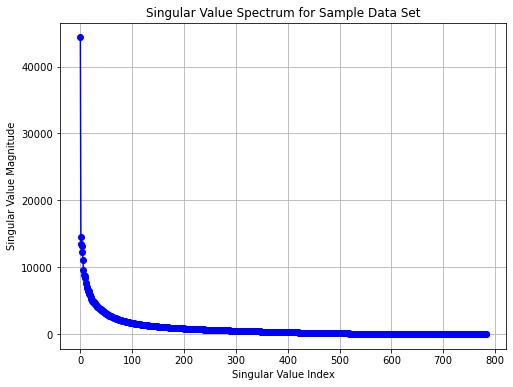

In [60]:
sampledf = mnist_df.sample(n=784) 
sampledf = sampledf.drop(columns='label')

U_samp, S_samp, V_samp = np.linalg.svd(sampledf.to_numpy().astype(float))

print(U_samp.shape)
print(S_samp.shape)
print(V_samp.shape)

plt.figure(figsize=(8, 6))
plt.plot(S_samp, marker='o', linestyle='-', color='b')
plt.title("Singular Value Spectrum for Sample Data Set")
plt.xlabel("Singular Value Index")
plt.ylabel("Singular Value Magnitude")
plt.grid(True)
plt.show()

Based on the plot of singular values above for the sampled dataset, we would choose rank 100 as it seems to be the elbow of the curve, meaning that with rank 100 we will hopefully get a reasonable approximation o fthe dataset without losing too much information.

e) Plot the first 10 singular vectors. Notice that each singular vector's length will be 784 so you can plot them as a 28x28 image. (5points)

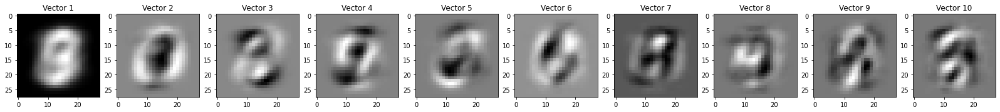

In [61]:
fig, axes = plt.subplots(1, 10, figsize=(28, 28))

for i in range(10):
    ax = axes[i]
    singular_vector = V_samp[i]
    ax.imshow(singular_vector.reshape(28, 28), cmap='gray')
    ax.set_title(f'Vector {i + 1}')

plt.show()

f) Using Kmeans on this new dataset, cluster the images from d) using 10 clusters and plot the centroid of each cluster. Note: the centroids should be represented as images. (10 points)

[[ 4.09424485e-13 -1.86411439e-12  2.01342193e-12 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [-1.80648032e-14 -4.63788366e-13  9.32761541e-13 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [-4.34175470e-14 -9.67666712e-13 -1.31003766e-12 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 ...
 [-2.52756021e-14 -1.37344323e-12 -5.53676050e-13 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [ 4.55156420e-14 -1.48085173e-12  9.21593507e-13 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [ 3.48868565e-14 -7.06385210e-14 -1.10593221e-13 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]]
(784, 784)


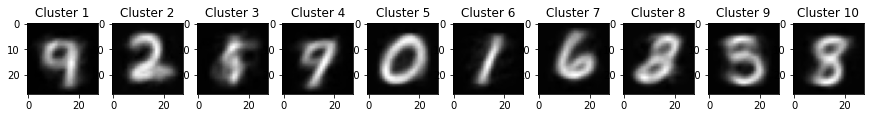

In [62]:
from sklearn.cluster import KMeans

S_samp_r = S_samp.copy()
S_samp_r[100:] = 0

reconstruct_sampledf = U_samp.dot(np.diag(S_samp_r)).dot(V_samp)
print(reconstruct_sampledf)
print(reconstruct_sampledf.shape)

# your code here
kmeans = KMeans(n_clusters=10, random_state=0)
image_labels = kmeans.fit_predict(reconstruct_sampledf)

# Get the centroids of each cluster
cluster_centers = kmeans.cluster_centers_

# Plot the centroids of each cluster
fig, axes = plt.subplots(1, 10, figsize=(15, 3))

for i in range(10):
    ax = axes[i]
    centroid = cluster_centers[i]
    ax.imshow(centroid.reshape(28, 28), cmap='gray')
    ax.set_title(f'Cluster {i + 1}')

plt.show()

g) Repeat f) on the original dataset (if you used a subset of the dataset, keep using that same subset). Comment on any differences (or lack thereof) you observe between the centroids. (5 points)

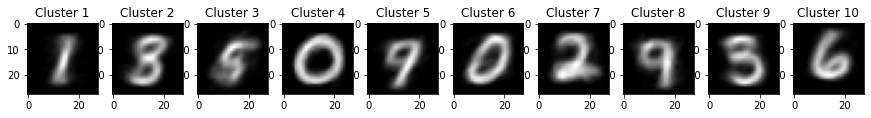

In [63]:
kmeans_orig = KMeans(n_clusters=10, random_state=0)
image_labels_orig = kmeans_orig.fit_predict(sampledf)

# Get the centroids of each cluster
cluster_centers_orig = kmeans_orig.cluster_centers_

# Plot the centroids of each cluster
fig, axes = plt.subplots(1, 10, figsize=(15, 3))

for i in range(10):
    ax = axes[i]
    centroid = cluster_centers_orig[i]
    ax.imshow(centroid.reshape(28, 28), cmap='gray')
    ax.set_title(f'Cluster {i + 1}')

plt.show()

There is a slight difference in the frequency of numbers in centroids between the origin sample of the dataset and the reconstructed sample. In the original, two centroids display an image of the number 0 and only one centroid displays 1. Conversely, in the reconstructed two centroids display the image 1 and only one centroid displays 0. Otherwise, they are the same.

h) Create a matrix (let's call it `O`) that is the difference between the original dataset and the rank-10 approximation of the dataset. (5 points)

In [64]:
S_samp_10 = S_samp.copy()
S_samp_10[10:] = 0
rank10_sampledf = U_samp.dot(np.diag(S_samp_10)).dot(V_samp)
print(rank10_sampledf)
O = sampledf-rank10_sampledf
print(O)

[[ 6.24638234e-14 -2.02586507e-12  1.00446362e-12 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [-7.11294453e-15 -6.88469329e-13  4.83579913e-13 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [-2.50498350e-15 -9.99036908e-13 -4.85332388e-13 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 ...
 [ 9.63868867e-16 -1.31860606e-12 -5.29012022e-13 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [ 2.79166903e-14 -1.33836323e-12  4.99074535e-13 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]
 [-1.49367583e-14 -2.87783030e-13 -2.66606489e-13 ...  0.00000000e+00
   0.00000000e+00  0.00000000e+00]]
                  0             1             2             3             4  \
66138 -6.246382e-14  2.025865e-12 -1.004464e-12 -9.001156e-14  8.423493e-14   
5953   7.112945e-15  6.884693e-13 -4.835799e-13  1.322624e-13  7.557071e-14   
46910  2.504983e-15  9.990369e-13  4.853324e-13 -3.685052e-14 -1.048669e-13   
2344  -1.725179e-14  7.054359e-13 -7.156718e-13 

i) The largest (using euclidean distance from the origin) rows of the matrix `O` could be considered anomalous data points. Briefly explain why. Plot the 10 images responsible for the 10 largest rows of that matrix `O`. (10 points)

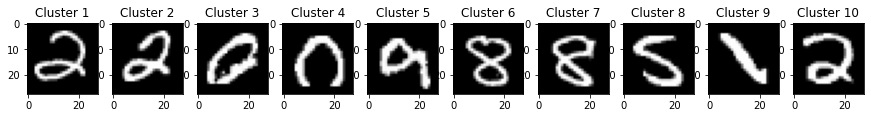

In [65]:
differences = np.linalg.norm(O, axis=1)
top_10_diff = np.argsort(differences)[-10:]
top_10_rows = sampledf.iloc[top_10_diff].to_numpy(dtype=float)

fig, axes = plt.subplots(1, 10, figsize=(15, 3))

for i in range(10):
    ax = axes[i]
    image = top_10_rows[i]
    ax.imshow(image.reshape(28, 28), cmap='gray')
    ax.set_title(f'Cluster {i + 1}')

plt.show()

The rows with the largest euclidian distance from the orgin can be considered anomalous data points because that means there is the greatest reconstruction error for those images. This means that those images behave differently than the predicted trends in the rank-10 reconstruction. 

## Bonus (20pts)

Re-using the dbscan code written in class, reproduce the following animation of the dbscan algorithm

In [ ]:
from IPython.display import Image
Image(filename="dbscan.gif", width=500, height=500)

Hints:

- First animate the dbscan algorithm for the dataset used in class (before trying to create the above dataset)
- Take a snapshot of the assignments when the point gets assigned to a cluster
- Confirm that the snapshot works by saving it to a file
- Don't forget to close the matplotlib plot after saving the figure
- Gather the snapshots in a list of images that you can then save as a gif using the code below
- Use `ax.set_aspect('equal')` so that the circles don't appear to be oval shaped
- To create the above dataset you need two blobs for the eyes. For the mouth you can use the following process to generate (x, y) pairs:
  - Pick an x at random in an interval that makes sense given where the eyes are positioned
  - For that x generate y that is 0.2 * x^2 plus a small amount of randomness
  - `zip` the x's and y's together and append them to the dataset containing the blobs



In [ ]:
import numpy as np
from PIL import Image as im
import matplotlib.pyplot as plt
import sklearn.datasets as datasets

TEMPFILE = 'temp.png'

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts 
        self.epsilon = epsilon
        self.snaps = []


    def snapshot(self):
        fig, ax = plt.subplots()
        colors = ...

        ax.scatter(...)
        cir = plt.Circle(...) # create circle around the point assigned
        ax.add_patch(cir)
        ax.set_xlim(...)
        ax.set_ylim(...)
        ax.set_aspect('equal') # necessary or else the circles appear to be oval shaped

        fig.savefig(TEMPFILE)
        plt.close()

        return im.fromarray(np.asarray(im.open(TEMPFILE)))


    def dbscan(self):
        ...
        return


centers = [...]
eyes, _ = datasets.make_blobs(...)

mouth_x = ... * np.random.random(...)
mouth_y = ... + .1 * np.random.randn(...)

face = np.append(eyes, ..., axis=0)

dbc = DBC(face, ..., ...)
clustering = dbc.dbscan()

dbc.snaps[0].save(
    'dbscan.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)